# Client Olist - Phase 1 Nettoyage et assemblage


## Importation des fichiers

In [860]:
import pandas as pd
import numpy as np
import missingno as msno

In [861]:
df_customer = pd.read_csv('./DATA/df_customer.csv')
df_geolocation = pd.read_csv('./DATA/df_geolocation.csv')
df_seller_geo = pd.read_csv('./DATA/df_geolocation.csv')
df_order_items = pd.read_csv('./DATA/df_order_items.csv')
df_order_payements = pd.read_csv('./DATA/df_order_payements.csv')
df_order_reviews = pd.read_csv('./DATA/df_order_reviews.csv')
df_order = pd.read_csv('./DATA/df_order.csv')
df_product = pd.read_csv('./DATA/df_product.csv')
df_sellers = pd.read_csv('./DATA/df_sellers.csv')

# Nombre de ligne et de colonne

In [862]:
print('Data customer', df_customer.shape)
print('Data geolocation', df_geolocation.shape)
print('Data order items', df_order_items.shape)
print('Data payements', df_order_payements.shape)
print('Data order reviews', df_order_reviews.shape)
print('Data order', df_order.shape)
print('Data product', df_product.shape)
print('Data sellers', df_sellers.shape)

Data customer (99441, 5)
Data geolocation (19023, 4)
Data order items (112650, 7)
Data payements (103886, 5)
Data order reviews (99224, 7)
Data order (99441, 8)
Data product (32951, 9)
Data sellers (3095, 4)


In [863]:
df_order

,order_id,customer_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,0.0,59.0,242.0,183.0,-8.0
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2.0,2.0,-16.0,-18.0,-36.0
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,0.0,0.0,9.0,9.0,130.0
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,0.0,4.0,-279.0,-283.0,-306.0
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,0.0,1.0,3.0,2.0,-10.0
...,...,...,...,...,...,...,...,...
99436,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,0.0,30.0,-170.0,-200.0,-11.0
99437,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,0.0,30.0,-94.0,-124.0,25.0
99438,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,0.0,1.0,25.0,24.0,-6.0
99439,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,0.0,122.0,-188.0,-310.0,-21.0


In [864]:
df_geolocation.columns

Index(['geolocation_zip_code_prefix', 'geolocation_state', 'geolocation_lng',
       'geolocation_lat'],
      dtype='object')

In [865]:
df_geolocation

,geolocation_zip_code_prefix,geolocation_state,geolocation_lng,geolocation_lat
0,1001,SP,-46.634024,-23.550190
1,1002,SP,-46.634979,-23.548146
2,1003,SP,-46.635731,-23.548994
3,1004,SP,-46.634757,-23.549799
4,1005,SP,-46.636733,-23.549456
...,...,...,...,...
19018,99960,RS,-52.025511,-27.953722
19019,99965,RS,-52.039850,-28.183372
19020,99970,RS,-51.874689,-28.343766
19021,99980,RS,-51.843836,-28.389129


In [866]:
df_seller_geo.rename(columns={'geolocation_zip_code_prefix': 'sellers_geolocation_zip_code_prefix', 
                           'geolocation_state': 'sellers_geolocation_state', 'geolocation_lng': 'sellers_geolocation_lng', 'geolocation_lat': 'sellers_geolocation_lat'}, inplace=True)

In [867]:
df_geolocation.columns

Index(['geolocation_zip_code_prefix', 'geolocation_state', 'geolocation_lng',
       'geolocation_lat'],
      dtype='object')

In [868]:
df_seller_geo

,sellers_geolocation_zip_code_prefix,sellers_geolocation_state,sellers_geolocation_lng,sellers_geolocation_lat
0,1001,SP,-46.634024,-23.550190
1,1002,SP,-46.634979,-23.548146
2,1003,SP,-46.635731,-23.548994
3,1004,SP,-46.634757,-23.549799
4,1005,SP,-46.636733,-23.549456
...,...,...,...,...
19018,99960,RS,-52.025511,-27.953722
19019,99965,RS,-52.039850,-28.183372
19020,99970,RS,-51.874689,-28.343766
19021,99980,RS,-51.843836,-28.389129


In [869]:
print('Data customer', df_customer.columns)
print('Data geolocation', df_geolocation.columns)
print('Data order items', df_order_items.columns)
print('Data payements', df_order_payements.columns)
print('Data order reviews', df_order_reviews.columns)
print('Data order', df_order.columns)
print('Data product', df_product.columns)
print('Data sellers', df_sellers.columns)
# print('Data Product Category', df_product_category.columns)

Data customer Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state'],
      dtype='object')
Data geolocation Index(['geolocation_zip_code_prefix', 'geolocation_state', 'geolocation_lng',
       'geolocation_lat'],
      dtype='object')
Data order items Index(['order_id', 'order_item_id', 'product_id', 'seller_id',
       'shipping_limit_date', 'price', 'freight_value'],
      dtype='object')
Data payements Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value'],
      dtype='object')
Data order reviews Index(['review_id', 'order_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp'],
      dtype='object')
Data order Index(['order_id', 'customer_id', 'order_status', 'delai_commande',
       'delai_expedition', 'delai_livraison', 'delivery_on_times1',
       'delivery_on_times2'],
      dtype='object')

In [870]:
df_customer[df_customer['customer_id'] == '06b8999e2fba1a1fbc88172c00ba8bc7']

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP


In [871]:
df_order[df_order['customer_id'] == '06b8999e2fba1a1fbc88172c00ba8bc7']

,order_id,customer_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2
88492,00e7ee1b050b8499577073aeb2a297a1,06b8999e2fba1a1fbc88172c00ba8bc7,delivered,0.0,7.0,9.0,2.0,19.0


In [872]:
df_customer_order = pd.merge(df_customer, df_order)
df_customer_order.shape

(99441, 12)

In [873]:
df_customer_order_reviews = pd.merge(df_customer_order, df_order_reviews, how="left", on=["order_id", "order_id"])
df_customer_order_reviews.shape

(99992, 18)

In [874]:
df_customer_order_reviews.head(5)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,88b8b52d46df026a9d1ad2136a59b30b,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,02fc48a9efa3e3d0f1a8ea26507eeec3,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5ad6695d76ee186dc473c42706984d87,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,059a801bb31f6aab2266e672cab87bc5,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,8490879d58d6c5d7773f2739a03f089a,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52


In [875]:
df_customer_order_reviews['review_score'].isnull().sum()

768

In [876]:
df_customer_order_reviews_payements = pd.merge(df_customer_order_reviews, df_order_payements, how="left", on=["order_id", "order_id"])
df_customer_order_reviews_payements.shape

(104478, 22)

In [877]:
df_customer_order_reviews_payements.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,payment_sequential,payment_type,payment_installments,payment_value
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,88b8b52d46df026a9d1ad2136a59b30b,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,1.0,credit_card,2.0,146.87
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,02fc48a9efa3e3d0f1a8ea26507eeec3,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,1.0,credit_card,8.0,335.48
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5ad6695d76ee186dc473c42706984d87,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,1.0,credit_card,7.0,157.73
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,059a801bb31f6aab2266e672cab87bc5,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,1.0,credit_card,1.0,173.30
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,8490879d58d6c5d7773f2739a03f089a,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1.0,credit_card,8.0,252.25


In [878]:
df_order_items

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14
...,...,...,...,...,...,...,...
112645,fffc94f6ce00a00581880bf54a75a037,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-05-02 04:11:01,299.99,43.41
112646,fffcd46ef2263f404302a634eb57f7eb,1,32e07fd915822b0765e448c4dd74c828,f3c38ab652836d21de61fb8314b69182,2018-07-20 04:31:48,350.00,36.53
112647,fffce4705a9662cd70adb13d4a31832d,1,72a30483855e2eafc67aee5dc2560482,c3cfdc648177fdbbbb35635a37472c53,2017-10-30 17:14:25,99.90,16.95
112648,fffe18544ffabc95dfada21779c9644f,1,9c422a519119dcad7575db5af1ba540e,2b3e4a2a3ea8e01938cabda2a3e5cc79,2017-08-21 00:04:32,55.99,8.72


In [879]:
df_customer_order_reviews_payements_items = pd.merge(df_customer_order_reviews_payements, df_order_items, how="left", on=["order_id", "order_id"])
df_customer_order_reviews_payements_items.shape

(119143, 28)

In [880]:
df_customer_order_reviews_payements_items


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,88b8b52d46df026a9d1ad2136a59b30b,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,02fc48a9efa3e3d0f1a8ea26507eeec3,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5ad6695d76ee186dc473c42706984d87,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,059a801bb31f6aab2266e672cab87bc5,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,8490879d58d6c5d7773f2739a03f089a,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,3937,sao paulo,SP,6760e20addcf0121e9d58f2f1ff14298,delivered,0.0,123.0,-82.0,-205.0,-12.0,36e2cdbaa9f639b57c53b37ac798fee8,4.0,Recomendo,NaN,2018-04-14 00:00:00,2018-04-28 11:15:04,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12 16:08:45,74.90,13.88
119139,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,6764,taboao da serra,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,0.0,30.0,214.0,184.0,198.0,b273b431c3aedb4eed18643309652940,5.0,NaN,NaN,2018-04-12 00:00:00,2018-04-16 10:36:05,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10 08:35:12,114.90,14.16
119140,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,CE,fed4434add09a6f332ea398efd656a5c,delivered,0.0,31.0,32.0,1.0,212.0,fa4f16891e6b2edd1354668d07f5648b,1.0,Chateada,Esperava qualidade no atendimento e estou tend...,2018-05-04 00:00:00,2018-05-08 01:41:07,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12 20:30:03,37.00,19.04
119141,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS,e31ec91cea1ecf97797787471f98a8c2,delivered,0.0,92.0,250.0,158.0,188.0,0bcdc9e450ea500811a8d39ee993cd47,5.0,NaN,NaN,2017-11-17 00:00:00,2017-11-19 23:34:18,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b

In [881]:
df_customer_order_reviews_payements_items = pd.merge(df_customer_order_reviews_payements, df_order_items, how="left", on=["order_id", "order_id"])
df_customer_order_reviews_payements_items.shape

(119143, 28)

In [882]:
df_customer_order_reviews_payements_items.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state', 'order_id', 'order_status',
       'delai_commande', 'delai_expedition', 'delai_livraison',
       'delivery_on_times1', 'delivery_on_times2', 'review_id', 'review_score',
       'review_comment_title', 'review_comment_message',
       'review_creation_date', 'review_answer_timestamp', 'payment_sequential',
       'payment_type', 'payment_installments', 'payment_value',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value'],
      dtype='object')

In [883]:
df_customer_order_reviews_payements_items.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,88b8b52d46df026a9d1ad2136a59b30b,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,02fc48a9efa3e3d0f1a8ea26507eeec3,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5ad6695d76ee186dc473c42706984d87,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,059a801bb31f6aab2266e672cab87bc5,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,8490879d58d6c5d7773f2739a03f089a,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25


In [884]:
df_customer_order_reviews_payements_items_product = pd.merge(df_customer_order_reviews_payements_items, df_product, how="left", on=["product_id", "product_id"])
df_customer_order_reviews_payements_items_product.shape

(119143, 36)

In [885]:
df_customer_order_reviews_payements_items_product.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,88b8b52d46df026a9d1ad2136a59b30b,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,02fc48a9efa3e3d0f1a8ea26507eeec3,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,utilidades_domesticas,43.0,1002.0,3.0,10150.0,89.0,15.0,40.0
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5ad6695d76ee186dc473c42706984d87,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,moveis_escritorio,55.0,955.0,1.0,8267.0,52.0,52.0,17.0
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,059a801bb31f6aab2266e672cab87bc5,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,moveis_escritorio,48.0,1066.0,1.0,12160.0,56.0,51.0,28.0
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,8490879d58d6c5d7773f2739a03f089a,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,casa_conforto,61.0,407.0,1.0,5200.0,45.0,15.0,35.0


In [886]:
df_customer_order_reviews_payements_items_product_seller = pd.merge(df_customer_order_reviews_payements_items_product, df_sellers, how="left", on=["seller_id", "seller_id"])
df_customer_order_reviews_payements_items_product_seller.shape

(119143, 39)

In [887]:
df_customer_order_reviews_payements_items_product_seller

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,88b8b52d46df026a9d1ad2136a59b30b,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,8577.0,itaquaquecetuba,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,02fc48a9efa3e3d0f1a8ea26507eeec3,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,utilidades_domesticas,43.0,1002.0,3.0,10150.0,89.0,15.0,40.0,88303.0,itajai,SC
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5ad6695d76ee186dc473c42706984d87,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,moveis_escritorio,55.0,955.0,1.0,8267.0,52.0,52.0,17.0,8577.0,itaquaquecetuba,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,059a801bb31f6aab2266e672cab87bc5,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,moveis_escritorio,48.0,1066.0,1.0,12160.0,56.0,51.0,28.0,8577.0,itaquaquecetuba,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,8490879d58d6c5d7773f2739a03f089a,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,casa_conforto,61.0,407.0,1.0,5200.0,45.0,15.0,35.0,14940.0,ibitinga,SP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,3937,sao paulo,SP,6760e20addcf0121e9d58f2f1ff14298,delivered,0.0,123.0,-82.0,-205.0,-12.0,36e2cdbaa9f639b57c53b37ac798fee8,4.0,Recomendo,NaN,2018-04-14 00:00:00,2018-04-28 11:15:04,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12 16:08:45,74.90,13.88,livros_interesse_geral,51.0,489.0,2.0,611.0,22.0,22.0,23.0,17400.0,garca,SP
119139,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,6764,taboao da serra,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,0.0,30.0,214.0,184.0,198.0,b273b431c3aedb4eed18643309652940,5.0,NaN,NaN,2018-04-12 00:00:00,2018-04-16 10:36:05,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10 08:35:12,114.90,14.16,esporte_lazer,51.0,1193.0,1.0,1211.0,

In [888]:
# df_full1 = pd.merge(df_customer_order_reviews_payements_items_product_seller, df_geolocation, how="left", left_on="customer_zip_code_prefix", right_on= "geolocation_zip_code_prefix")
# df_full1.shape

In [889]:
# df_full1

In [890]:
df_full = df_customer_order_reviews_payements_items_product_seller

df_full.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state', 'order_id', 'order_status',
       'delai_commande', 'delai_expedition', 'delai_livraison',
       'delivery_on_times1', 'delivery_on_times2', 'review_id', 'review_score',
       'review_comment_title', 'review_comment_message',
       'review_creation_date', 'review_answer_timestamp', 'payment_sequential',
       'payment_type', 'payment_installments', 'payment_value',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'seller_zip_code_prefix',
       'seller_city', 'seller_state'],
      dtype='object')

In [891]:
# df_full = pd.merge(df_full1, df_seller_geo, how="left", left_on="seller_zip_code_prefix", right_on= "sellers_geolocation_zip_code_prefix")
# df_full.shape

In [892]:
# df_full.columns

In [893]:
# df_customer_order_reviews_payements_items_product_seller.to_csv('dataframe.csv',index=False)

In [894]:
for i in df_full.columns:
    if df_full[i].isna().sum() != 0:
        print(f'Colonne {i} il y a {df_full[i].isna().sum()} null')

Colonne delai_commande il y a 177 null
Colonne delai_expedition il y a 2086 null
Colonne delai_livraison il y a 3421 null
Colonne delivery_on_times1 il y a 3422 null
Colonne delivery_on_times2 il y a 3421 null
Colonne review_id il y a 997 null
Colonne review_score il y a 997 null
Colonne review_comment_title il y a 105154 null
Colonne review_comment_message il y a 68898 null
Colonne review_creation_date il y a 997 null
Colonne review_answer_timestamp il y a 997 null
Colonne payment_sequential il y a 3 null
Colonne payment_type il y a 3 null
Colonne payment_installments il y a 3 null
Colonne payment_value il y a 3 null
Colonne order_item_id il y a 833 null
Colonne product_id il y a 833 null
Colonne seller_id il y a 833 null
Colonne shipping_limit_date il y a 833 null
Colonne price il y a 833 null
Colonne freight_value il y a 833 null
Colonne product_category_name il y a 2542 null
Colonne product_name_lenght il y a 2542 null
Colonne product_description_lenght il y a 2542 null
Colonne pro

<AxesSubplot:>

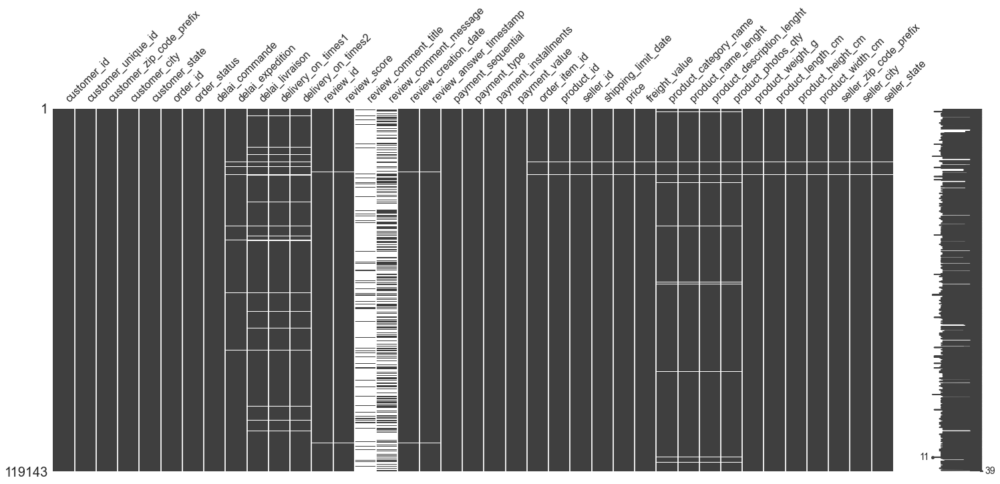

In [895]:
msno.matrix(df_full)

<AxesSubplot:>

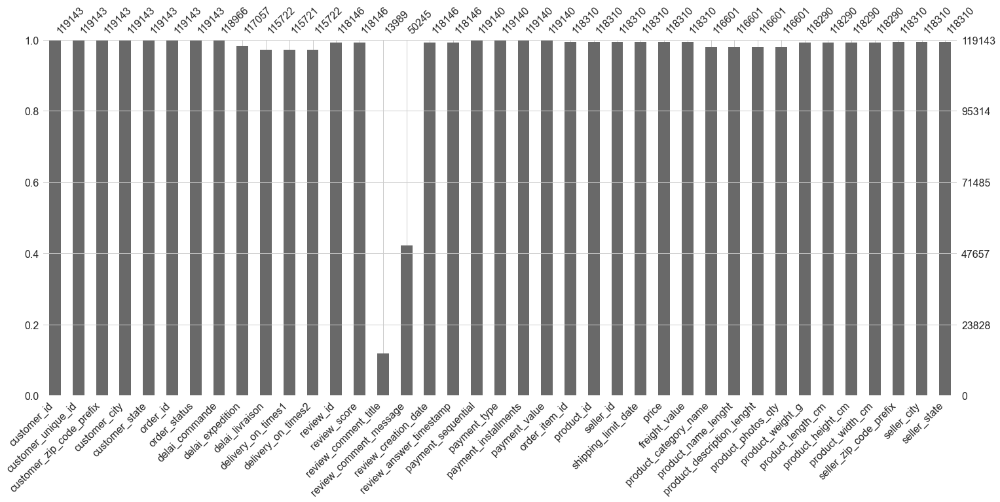

In [896]:
msno.bar(df_full)

<AxesSubplot:>

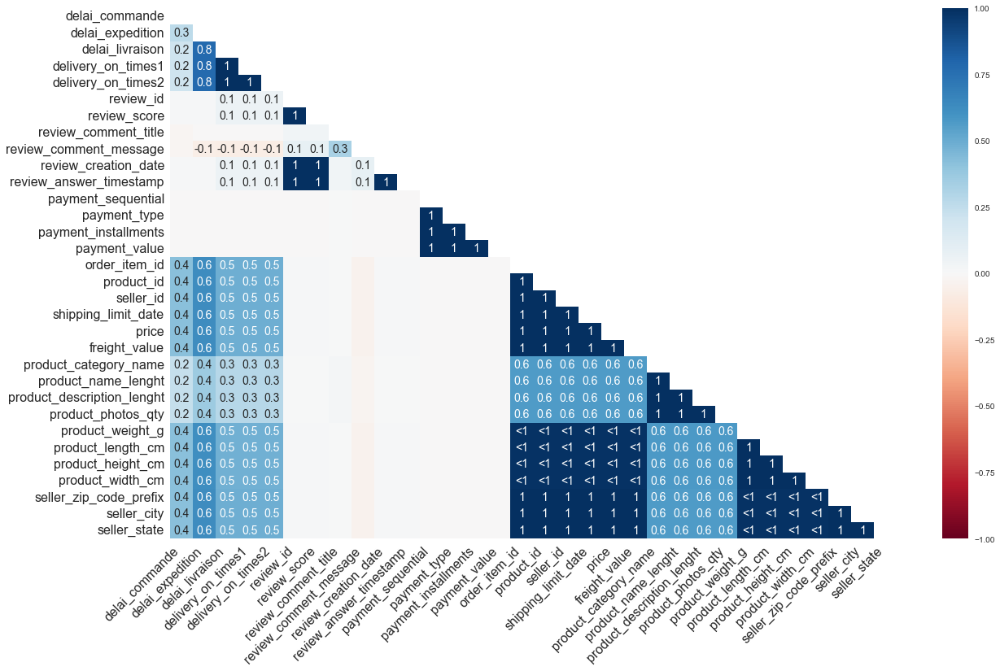

In [897]:
msno.heatmap(df_full)

In [898]:
df_full.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state', 'order_id', 'order_status',
       'delai_commande', 'delai_expedition', 'delai_livraison',
       'delivery_on_times1', 'delivery_on_times2', 'review_id', 'review_score',
       'review_comment_title', 'review_comment_message',
       'review_creation_date', 'review_answer_timestamp', 'payment_sequential',
       'payment_type', 'payment_installments', 'payment_value',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'seller_zip_code_prefix',
       'seller_city', 'seller_state'],
      dtype='object')

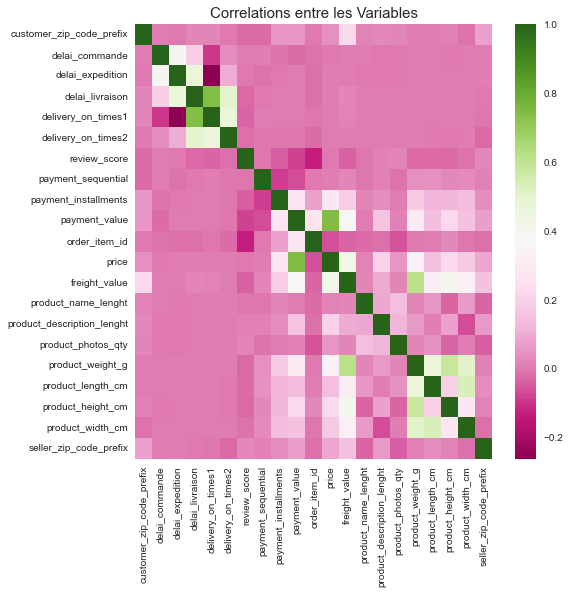

In [899]:
import matplotlib.pyplot as plt
import seaborn as sns
with sns.axes_style('ticks', {'figure.facecolor': 'white'}):
    plt.figure(figsize=(8,8))
    sns.heatmap(df_full.corr(),cmap="PiYG")
    plt.title("Correlations entre les Variables", size=15)
    plt.show()

In [900]:
pd.set_option('display.max_columns', None)
df_full

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,88b8b52d46df026a9d1ad2136a59b30b,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,8577.0,itaquaquecetuba,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,02fc48a9efa3e3d0f1a8ea26507eeec3,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,utilidades_domesticas,43.0,1002.0,3.0,10150.0,89.0,15.0,40.0,88303.0,itajai,SC
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5ad6695d76ee186dc473c42706984d87,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,moveis_escritorio,55.0,955.0,1.0,8267.0,52.0,52.0,17.0,8577.0,itaquaquecetuba,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,059a801bb31f6aab2266e672cab87bc5,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,moveis_escritorio,48.0,1066.0,1.0,12160.0,56.0,51.0,28.0,8577.0,itaquaquecetuba,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,8490879d58d6c5d7773f2739a03f089a,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,casa_conforto,61.0,407.0,1.0,5200.0,45.0,15.0,35.0,14940.0,ibitinga,SP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,3937,sao paulo,SP,6760e20addcf0121e9d58f2f1ff14298,delivered,0.0,123.0,-82.0,-205.0,-12.0,36e2cdbaa9f639b57c53b37ac798fee8,4.0,Recomendo,NaN,2018-04-14 00:00:00,2018-04-28 11:15:04,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12 16:08:45,74.90,13.88,livros_interesse_geral,51.0,489.0,2.0,611.0,22.0,22.0,23.0,17400.0,garca,SP
119139,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,6764,taboao da serra,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,0.0,30.0,214.0,184.0,198.0,b273b431c3aedb4eed18643309652940,5.0,NaN,NaN,2018-04-12 00:00:00,2018-04-16 10:36:05,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10 08:35:12,114.90,14.16,esporte_lazer,51.0,1193.0,1.0,1211.0,

In [901]:
df_full['is_same_city'] = df_full['customer_city'] == df_full['seller_city']
df_full['is_same_state'] = df_full['customer_state'] == df_full['seller_state']
df_full

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,is_same_city,is_same_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,88b8b52d46df026a9d1ad2136a59b30b,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,8577.0,itaquaquecetuba,SP,False,True
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,02fc48a9efa3e3d0f1a8ea26507eeec3,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,utilidades_domesticas,43.0,1002.0,3.0,10150.0,89.0,15.0,40.0,88303.0,itajai,SC,False,False
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5ad6695d76ee186dc473c42706984d87,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,moveis_escritorio,55.0,955.0,1.0,8267.0,52.0,52.0,17.0,8577.0,itaquaquecetuba,SP,False,True
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,059a801bb31f6aab2266e672cab87bc5,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,moveis_escritorio,48.0,1066.0,1.0,12160.0,56.0,51.0,28.0,8577.0,itaquaquecetuba,SP,False,True
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,8490879d58d6c5d7773f2739a03f089a,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,casa_conforto,61.0,407.0,1.0,5200.0,45.0,15.0,35.0,14940.0,ibitinga,SP,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,3937,sao paulo,SP,6760e20addcf0121e9d58f2f1ff14298,delivered,0.0,123.0,-82.0,-205.0,-12.0,36e2cdbaa9f639b57c53b37ac798fee8,4.0,Recomendo,NaN,2018-04-14 00:00:00,2018-04-28 11:15:04,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12 16:08:45,74.90,13.88,livros_interesse_geral,51.0,489.0,2.0,611.0,22.0,22.0,23.0,17400.0,garca,SP,False,True
119139,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,6764,taboao da serra,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,0.0,30.0,214.0,184.0,198.0,b273b431c3aedb4eed18643309652940,5.0,NaN,NaN,2018-04-12 00:00:00,2018-04-16 10:36:05,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3

In [902]:
df_full = df_full.drop(['customer_zip_code_prefix', 'customer_city', 'customer_state'], axis = 1)

In [903]:
df_full = df_full.drop(['review_id', 'product_id', 'payment_value','shipping_limit_date','seller_zip_code_prefix','seller_city','seller_state'], axis = 1)

In [904]:
df_full['Volume en m3'] = round((df_full['product_length_cm'] * df_full['product_height_cm'] * df_full['product_width_cm']) / 1000000 ,2)
df_full

,customer_id,customer_unique_id,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,payment_sequential,payment_type,payment_installments,order_item_id,seller_id,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,is_same_city,is_same_state,Volume en m3
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,1.0,credit_card,2.0,1.0,7c67e1448b00f6e969d365cea6b010ab,124.99,21.88,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,False,True,0.11
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,1.0,credit_card,8.0,1.0,b8bc237ba3788b23da09c0f1f3a3288c,289.00,46.48,utilidades_domesticas,43.0,1002.0,3.0,10150.0,89.0,15.0,40.0,False,False,0.05
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,1.0,credit_card,7.0,1.0,7c67e1448b00f6e969d365cea6b010ab,139.94,17.79,moveis_escritorio,55.0,955.0,1.0,8267.0,52.0,52.0,17.0,False,True,0.05
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,1.0,credit_card,1.0,1.0,7c67e1448b00f6e969d365cea6b010ab,149.94,23.36,moveis_escritorio,48.0,1066.0,1.0,12160.0,56.0,51.0,28.0,False,True,0.08
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1.0,credit_card,8.0,1.0,4a3ca9315b744ce9f8e9374361493884,230.00,22.25,casa_conforto,61.0,407.0,1.0,5200.0,45.0,15.0,35.0,False,True,0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,6760e20addcf0121e9d58f2f1ff14298,delivered,0.0,123.0,-82.0,-205.0,-12.0,4.0,Recomendo,NaN,2018-04-14 00:00:00,2018-04-28 11:15:04,1.0,credit_card,6.0,1.0,527801b552d0077ffd170872eb49683b,74.90,13.88,livros_interesse_geral,51.0,489.0,2.0,611.0,22.0,22.0,23.0,False,True,0.01
119139,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,0.0,30.0,214.0,184.0,198.0,5.0,NaN,NaN,2018-04-12 00:00:00,2018-04-16 10:36:05,1.0,credit_card,3.0,1.0,3fd1e727ba94cfe122d165e176ce7967,114.90,14.16,esporte_lazer,51.0,1193.0,1.0,1211.0,25.0,24.0,22.0,False,True,0.01
119140,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,fed4434add09a6f332ea398efd656a5c,delivered,0.0,31.0,32.0,1.0,212.0,1.0,Chateada,Esperava qualidade no atendimento e estou tend...,2018-05-04 00:00:00,2018-05-08 01:41:07,1.0,credit_card,5.0,1.0,d9e7e7778b32987280a6f2cb9a39c57d,37.00,19.04,beleza_saude,60.0,575.0,1.0,870.0,25.0,20.0,18.0,False,False,0.01
119141,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,e31ec91cea1ecf97797787471f98a8c2,delivered,0.0,92.0,250.0,158.0,188.0,5.0,NaN,NaN,2017-11-17 00:00:00,2017-11-19 23:34:18,1.0,credit_card,2.0,1.0,4869f7a5dfa277a7dca6462dcf3b52b2,689.00,22.07,relogios_presentes,59.0,452.0,1.0,710.0,19.0,13.0,14.0,False,False,0.00


In [905]:
df_full = df_full.drop(['product_length_cm','product_height_cm','product_width_cm'], axis = 1)

In [906]:
df_full

,customer_id,customer_unique_id,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,payment_sequential,payment_type,payment_installments,order_item_id,seller_id,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,is_same_city,is_same_state,Volume en m3
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,1.0,credit_card,2.0,1.0,7c67e1448b00f6e969d365cea6b010ab,124.99,21.88,moveis_escritorio,41.0,1141.0,1.0,8683.0,False,True,0.11
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,1.0,credit_card,8.0,1.0,b8bc237ba3788b23da09c0f1f3a3288c,289.00,46.48,utilidades_domesticas,43.0,1002.0,3.0,10150.0,False,False,0.05
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,1.0,credit_card,7.0,1.0,7c67e1448b00f6e969d365cea6b010ab,139.94,17.79,moveis_escritorio,55.0,955.0,1.0,8267.0,False,True,0.05
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,1.0,credit_card,1.0,1.0,7c67e1448b00f6e969d365cea6b010ab,149.94,23.36,moveis_escritorio,48.0,1066.0,1.0,12160.0,False,True,0.08
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1.0,credit_card,8.0,1.0,4a3ca9315b744ce9f8e9374361493884,230.00,22.25,casa_conforto,61.0,407.0,1.0,5200.0,False,True,0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,6760e20addcf0121e9d58f2f1ff14298,delivered,0.0,123.0,-82.0,-205.0,-12.0,4.0,Recomendo,NaN,2018-04-14 00:00:00,2018-04-28 11:15:04,1.0,credit_card,6.0,1.0,527801b552d0077ffd170872eb49683b,74.90,13.88,livros_interesse_geral,51.0,489.0,2.0,611.0,False,True,0.01
119139,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,0.0,30.0,214.0,184.0,198.0,5.0,NaN,NaN,2018-04-12 00:00:00,2018-04-16 10:36:05,1.0,credit_card,3.0,1.0,3fd1e727ba94cfe122d165e176ce7967,114.90,14.16,esporte_lazer,51.0,1193.0,1.0,1211.0,False,True,0.01
119140,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,fed4434add09a6f332ea398efd656a5c,delivered,0.0,31.0,32.0,1.0,212.0,1.0,Chateada,Esperava qualidade no atendimento e estou tend...,2018-05-04 00:00:00,2018-05-08 01:41:07,1.0,credit_card,5.0,1.0,d9e7e7778b32987280a6f2cb9a39c57d,37.00,19.04,beleza_saude,60.0,575.0,1.0,870.0,False,False,0.01
119141,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,e31ec91cea1ecf97797787471f98a8c2,delivered,0.0,92.0,250.0,158.0,188.0,5.0,NaN,NaN,2017-11-17 00:00:00,2017-11-19 23:34:18,1.0,credit_card,2.0,1.0,4869f7a5dfa277a7dca6462dcf3b52b2,689.00,22.07,relogios_presentes,59.0,452.0,1.0,710.0,False,False,0.00


In [907]:
df_full = df_full.drop(['product_description_lenght','product_name_lenght'], axis = 1)

In [908]:
df_full

,customer_id,customer_unique_id,order_id,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,payment_sequential,payment_type,payment_installments,order_item_id,seller_id,price,freight_value,product_category_name,product_photos_qty,product_weight_g,is_same_city,is_same_state,Volume en m3
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,00e7ee1b050b8499577073aeb2a297a1,delivered,0.0,7.0,9.0,2.0,19.0,4.0,NaN,NaN,2017-05-26 00:00:00,2017-05-30 22:34:40,1.0,credit_card,2.0,1.0,7c67e1448b00f6e969d365cea6b010ab,124.99,21.88,moveis_escritorio,1.0,8683.0,False,True,0.11
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,29150127e6685892b6eab3eec79f59c7,delivered,0.0,-320.0,-306.0,14.0,-124.0,5.0,NaN,NaN,2018-01-30 00:00:00,2018-02-10 22:43:29,1.0,credit_card,8.0,1.0,b8bc237ba3788b23da09c0f1f3a3288c,289.00,46.48,utilidades_domesticas,3.0,10150.0,False,False,0.05
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,1.0,171.0,26.0,-145.0,1.0,5.0,NaN,NaN,2018-06-15 00:00:00,2018-06-15 12:10:59,1.0,credit_card,7.0,1.0,7c67e1448b00f6e969d365cea6b010ab,139.94,17.79,moveis_escritorio,1.0,8267.0,False,True,0.05
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,951670f92359f4fe4a63112aa7306eba,delivered,0.0,14.0,15.0,1.0,-190.0,5.0,NaN,NaN,2018-03-29 00:00:00,2018-04-02 18:36:47,1.0,credit_card,1.0,1.0,7c67e1448b00f6e969d365cea6b010ab,149.94,23.36,moveis_escritorio,1.0,12160.0,False,True,0.08
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,0.0,1.0,41.0,40.0,24.0,5.0,a melhor nota,O baratheon è esxelente Amo adoro o baratheon,2018-08-10 00:00:00,2018-08-17 01:59:52,1.0,credit_card,8.0,1.0,4a3ca9315b744ce9f8e9374361493884,230.00,22.25,casa_conforto,1.0,5200.0,False,True,0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,6760e20addcf0121e9d58f2f1ff14298,delivered,0.0,123.0,-82.0,-205.0,-12.0,4.0,Recomendo,NaN,2018-04-14 00:00:00,2018-04-28 11:15:04,1.0,credit_card,6.0,1.0,527801b552d0077ffd170872eb49683b,74.90,13.88,livros_interesse_geral,2.0,611.0,False,True,0.01
119139,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,0.0,30.0,214.0,184.0,198.0,5.0,NaN,NaN,2018-04-12 00:00:00,2018-04-16 10:36:05,1.0,credit_card,3.0,1.0,3fd1e727ba94cfe122d165e176ce7967,114.90,14.16,esporte_lazer,1.0,1211.0,False,True,0.01
119140,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,fed4434add09a6f332ea398efd656a5c,delivered,0.0,31.0,32.0,1.0,212.0,1.0,Chateada,Esperava qualidade no atendimento e estou tend...,2018-05-04 00:00:00,2018-05-08 01:41:07,1.0,credit_card,5.0,1.0,d9e7e7778b32987280a6f2cb9a39c57d,37.00,19.04,beleza_saude,1.0,870.0,False,False,0.01
119141,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,e31ec91cea1ecf97797787471f98a8c2,delivered,0.0,92.0,250.0,158.0,188.0,5.0,NaN,NaN,2017-11-17 00:00:00,2017-11-19 23:34:18,1.0,credit_card,2.0,1.0,4869f7a5dfa277a7dca6462dcf3b52b2,689.00,22.07,relogios_presentes,1.0,710.0,False,False,0.00


In [909]:
nb_commande = df_full.groupby('customer_unique_id')['order_id'].size().reset_index(name='nb_commande')

In [910]:
df_full["nb_commande"] = nb_commande["nb_commande"] 

In [911]:
df_full = df_full.drop(['customer_id','order_id','review_creation_date','review_answer_timestamp'], axis = 1)

In [912]:
df_full = df_full.drop(['customer_unique_id','seller_id','review_comment_title','review_comment_message', 'product_category_name'], axis = 1)

In [913]:
df_full = df_full.fillna(0)
df_full

,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_score,payment_sequential,payment_type,payment_installments,order_item_id,price,freight_value,product_photos_qty,product_weight_g,is_same_city,is_same_state,Volume en m3,nb_commande
0,delivered,0.0,7.0,9.0,2.0,19.0,4.0,1.0,credit_card,2.0,1.0,124.99,21.88,1.0,8683.0,False,True,0.11,1.0
1,delivered,0.0,-320.0,-306.0,14.0,-124.0,5.0,1.0,credit_card,8.0,1.0,289.00,46.48,3.0,10150.0,False,False,0.05,1.0
2,delivered,1.0,171.0,26.0,-145.0,1.0,5.0,1.0,credit_card,7.0,1.0,139.94,17.79,1.0,8267.0,False,True,0.05,1.0
3,delivered,0.0,14.0,15.0,1.0,-190.0,5.0,1.0,credit_card,1.0,1.0,149.94,23.36,1.0,12160.0,False,True,0.08,1.0
4,delivered,0.0,1.0,41.0,40.0,24.0,5.0,1.0,credit_card,8.0,1.0,230.00,22.25,1.0,5200.0,False,True,0.02,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,delivered,0.0,123.0,-82.0,-205.0,-12.0,4.0,1.0,credit_card,6.0,1.0,74.90,13.88,2.0,611.0,False,True,0.01,0.0
119139,delivered,0.0,30.0,214.0,184.0,198.0,5.0,1.0,credit_card,3.0,1.0,114.90,14.16,1.0,1211.0,False,True,0.01,0.0
119140,delivered,0.0,31.0,32.0,1.0,212.0,1.0,1.0,credit_card,5.0,1.0,37.00,19.04,1.0,870.0,False,False,0.01,0.0
119141,delivered,0.0,92.0,250.0,158.0,188.0,5.0,1.0,credit_card,2.0,1.0,689.00,22.07,1.0,710.0,False,False,0.00,0.0


In [914]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 119143 entries, 0 to 119142
Data columns (total 19 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_status          119143 non-null  object 
 1   delai_commande        119143 non-null  float64
 2   delai_expedition      119143 non-null  float64
 3   delai_livraison       119143 non-null  float64
 4   delivery_on_times1    119143 non-null  float64
 5   delivery_on_times2    119143 non-null  float64
 6   review_score          119143 non-null  float64
 7   payment_sequential    119143 non-null  float64
 8   payment_type          119143 non-null  object 
 9   payment_installments  119143 non-null  float64
 10  order_item_id         119143 non-null  float64
 11  price                 119143 non-null  float64
 12  freight_value         119143 non-null  float64
 13  product_photos_qty    119143 non-null  float64
 14  product_weight_g      119143 non-null  float64
 15  

In [915]:
df_full['order_status'].unique()

array(['delivered', 'canceled', 'invoiced', 'shipped', 'processing',
       'unavailable', 'approved', 'created'], dtype=object)

In [916]:
df_full['payment_type'].unique()

df_full[df_full['payment_type']==0]
             


,order_status,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_score,payment_sequential,payment_type,payment_installments,order_item_id,price,freight_value,product_photos_qty,product_weight_g,is_same_city,is_same_state,Volume en m3,nb_commande
25365,delivered,0.0,-66.0,-4.0,62.0,154.0,1.0,0.0,0,0.0,1.0,44.99,2.83,1.0,1000.0,False,False,0.0,1.0
25366,delivered,0.0,-66.0,-4.0,62.0,154.0,1.0,0.0,0,0.0,2.0,44.99,2.83,1.0,1000.0,False,False,0.0,1.0
25367,delivered,0.0,-66.0,-4.0,62.0,154.0,1.0,0.0,0,0.0,3.0,44.99,2.83,1.0,1000.0,False,False,0.0,1.0


In [917]:
df_full.drop([25365, 25366,25367], inplace = True ) 

In [918]:
df_full["is_same_city"] = df_full["is_same_city"].replace(True, 1)
df_full["is_same_city"] = df_full["is_same_city"].replace(False, 0)

In [919]:
df_full["is_same_state"] = df_full["is_same_state"].replace(True, 1)
df_full["is_same_state"] = df_full["is_same_state"].replace(False, 0)

In [920]:
# transformer les données en array numpy
X = df_full.values

In [921]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer


num_attributes = df_full.select_dtypes(include=['float']).columns.tolist()
cat_attributes = df_full.select_dtypes(include=['object']).columns.tolist()

print(num_attributes)
print(cat_attributes)

['delai_commande', 'delai_expedition', 'delai_livraison', 'delivery_on_times1', 'delivery_on_times2', 'review_score', 'payment_sequential', 'payment_installments', 'order_item_id', 'price', 'freight_value', 'product_photos_qty', 'product_weight_g', 'Volume en m3', 'nb_commande']
['order_status', 'payment_type']


In [922]:
pipeline = ColumnTransformer([
        ('num', MinMaxScaler(), num_attributes),
        ('cat', OneHotEncoder(), cat_attributes),
])
df_prepared = pipeline.fit_transform(df_full)
df_prepared

array([[0.37225434, 0.42027194, 0.33496572, ..., 0.        , 0.        ,
        0.        ],
       [0.37225434, 0.01606922, 0.02644466, ..., 0.        , 0.        ,
        0.        ],
       [0.3734104 , 0.62299135, 0.35161606, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.37225434, 0.4499382 , 0.35749265, ..., 0.        , 0.        ,
        0.        ],
       [0.37225434, 0.52533993, 0.57100881, ..., 0.        , 0.        ,
        0.        ],
       [0.37225434, 0.41409147, 0.33300686, ..., 0.        , 0.        ,
        0.        ]])

In [923]:
df_prepared.shape


(119140, 28)

In [924]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.collections import LineCollection

def display_circles(pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None, title=None):
    for d1, d2 in axis_ranks: # On affiche les 3 premiers plans factoriels, donc les 6 premières composantes
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(7,6))

            # détermination des limites du graphique
            if lims is not None :
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30 :
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else :
                xmin, xmax, ymin, ymax = min(pcs[d1,:]), max(pcs[d1,:]), min(pcs[d2,:]), max(pcs[d2,:])

            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
            if pcs.shape[1] < 30 :
                plt.quiver(np.zeros(pcs.shape[1]), np.zeros(pcs.shape[1]),
                   pcs[d1,:], pcs[d2,:], 
                   angles='xy', scale_units='xy', scale=1, color="grey")
                # (voir la doc : https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html)
            else:
                lines = [[[0,0],[x,y]] for x,y in pcs[[d1,d2]].T]
                ax.add_collection(LineCollection(lines, axes=ax, alpha=.1, color='black'))
            
            # affichage des noms des variables  
            if labels is not None:  
                for i,(x, y) in enumerate(pcs[[d1,d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax :
                        plt.text(x, y, labels[i], fontsize='14', ha='center', va='center', rotation=label_rotation, color="blue", alpha=0.5)
            
            # affichage du cercle
            circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
            plt.gca().add_artist(circle)

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)
        
            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-1, 1], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('F{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Cercle des corrélations (F{} et F{})".format(d1+1, d2+1))
            plt.savefig(title)
            plt.show(block=False)
        
def display_factorial_planes(X_projected, n_comp, pca, axis_ranks, labels=None, alpha=1, illustrative_var=None, title=None, cmap=None):
    for d1,d2 in axis_ranks:
        if d2 < n_comp:
 
            # initialisation de la figure       
            fig = plt.figure(figsize=(7,6))
        
            # affichage des points
            if illustrative_var is None:
                plt.scatter(X_projected[:, d1], X_projected[:, d2], alpha=alpha)
            else:
                illustrative_var = np.array(illustrative_var)
                for value in np.unique(illustrative_var):
                    selected = np.where(illustrative_var == value)
                    plt.scatter(X_projected[selected, d1], X_projected[selected, d2], alpha=alpha, label=value, cmap=cmap)
                plt.legend()

            # affichage des labels des points
            if labels is not None:
                for i,(x,y) in enumerate(X_projected[:,[d1,d2]]):
                    plt.text(x, y, labels[i],
                              fontsize='14', ha='center',va='center') 
                
            # détermination des limites du graphique
            boundary = np.max(np.abs(X_projected[:, [d1,d2]])) * 1.1
            plt.xlim([-boundary,boundary])
            plt.ylim([-boundary,boundary])
        
            # affichage des lignes horizontales et verticales
            plt.plot([-100, 100], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-100, 100], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('F{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Projection des individus (sur F{} et F{})".format(d1+1, d2+1))
            plt.savefig(title)
            plt.show(block=False)

def display_scree_plot(pca):
    scree = pca.explained_variance_ratio_*100
    plt.bar(np.arange(len(scree))+1, scree)
    plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
    plt.xlabel("rang de l'axe d'inertie")
    plt.ylabel("pourcentage d'inertie")
    plt.title("Eboulis des valeurs propres")
    plt.show(block=False)


In [925]:
from sklearn.decomposition import PCA

pca = PCA(n_components=6)


df_reduced = pca.fit_transform(df_prepared)
df_reduced.shape

(119140, 6)

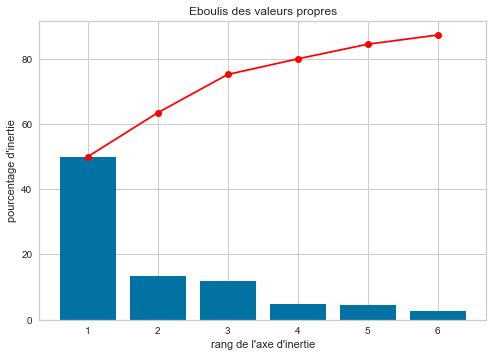

In [926]:
display_scree_plot(pca)

In [927]:
from sklearn.cluster import KMeans

k_range = range(2, 15)
kmeans_per_k = [KMeans(n_clusters=k, random_state=42).fit(df_reduced)
                for k in k_range]
inertias = [model.inertia_ for model in kmeans_per_k]

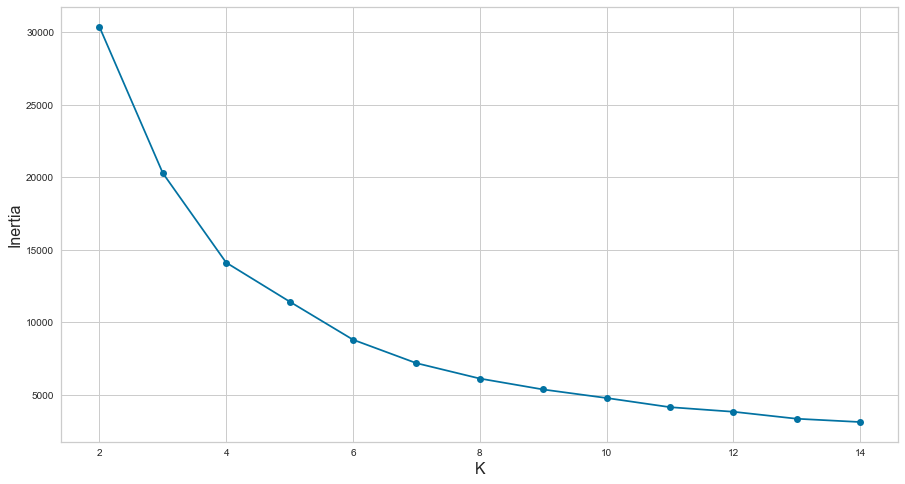

In [928]:
plt.figure(figsize=(15, 8))
plt.plot(k_range, inertias, 'bo-')
plt.xlabel('K', fontsize=16)
plt.ylabel('Inertia', fontsize=16)
plt.show()

In [929]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance
from kmodes.kprototypes import KPrototypes

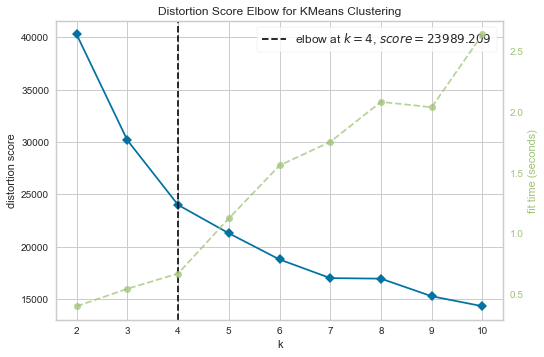

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [930]:
X = df_full.copy()

# Elbow method
kmeans_visualizer = Pipeline([
    ("preprocessor", pipeline),
    ("kelbowvisualizer", KElbowVisualizer(KMeans(),K=(1,12)))])
kmeans_visualizer.fit(X)
kmeans_visualizer.named_steps['kelbowvisualizer'].show()

Coefficient de silhouette

Pour vérifier si ce clustering fonctionne, nous allons utiliser SilhouetteVisualizer pour afficher le coefficient de silhouette pour un échantillonage de chaque cluster. Cela permet de visualiser la densité et la séparation des clusters.

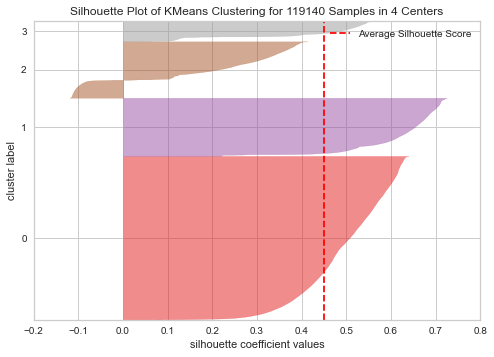

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 119140 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [931]:
# Best K in Elbow
K = kmeans_visualizer.named_steps['kelbowvisualizer'].elbow_value_
# Silhouette Visualizer
silhouette_visualizer = Pipeline([
    ("preprocessor", pipeline),
    ("silhouettevisualizer", SilhouetteVisualizer(KMeans(K)))])
silhouette_visualizer.fit(X)
silhouette_visualizer.named_steps['silhouettevisualizer'].show()

Le score de chaque échantillon est calculé en faisant la moyenne du coefficient de silhouette (différence entre la distance moyenne intra-cluster et la distance moyenne du cluster le plus proche pour chaque échantillon), normalisée par la valeur maximale. Cela nous donne un score entre -1 et 1, qui nous permet de déterminer si la séparation est efficace ou si les points sont assignés au mauvais cluster.

Ici, les clusters semblent relativement bien répartis et les séparations sont claires avec cependant quelques erreurs sur l'un des clusters.

A présent, nous allons tester d'autres types de métriques pour trouver le meilleur K :

Silouhette : rapport moyen entre la distance intra-cluster et la distance du cluster le plus proche,
Calinski Harabasz : rapport entre la dispersion des grappes dans et entre les groupes.

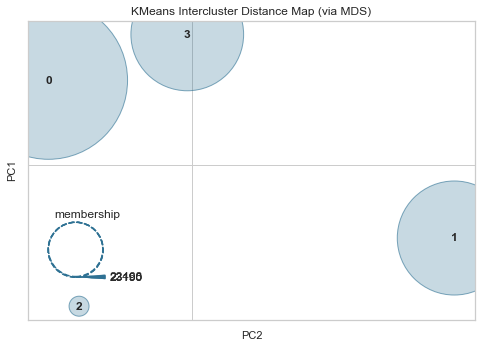

<AxesSubplot:title={'center':'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>

In [932]:
# Intercluster distance Map with best k
distance_visualizer = Pipeline([
    ("preprocessor", pipeline),
    ("distancevisualizer", InterclusterDistance(KMeans(K)))])
distance_visualizer.fit(X)
distance_visualizer.named_steps['distancevisualizer'].show()

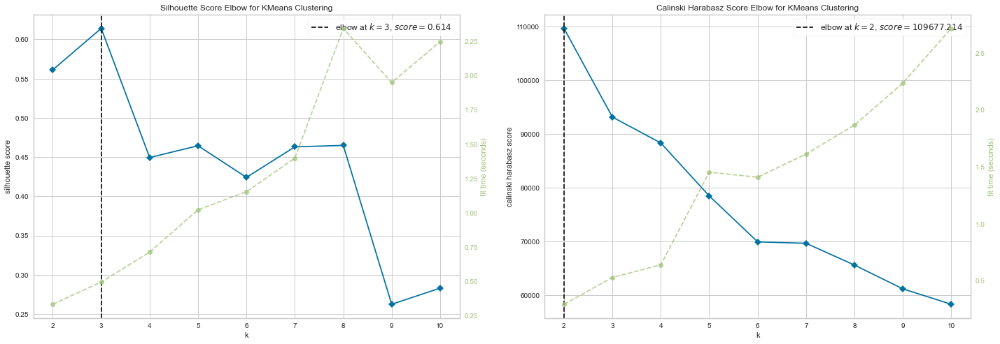

In [933]:
# Elbow method with differents metrics
metrics = ["silhouette", "calinski_harabasz"]
i = 0

fig, axes = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(24,8))
for m in metrics:
    kmeans_visualizer = Pipeline([
        ("preprocessor", pipeline),
        ("kelbowvisualizer", KElbowVisualizer(KMeans(),
                                              K=(4,10),
                                              metric=m,
                                              ax=axes[i]))])
    kmeans_visualizer.fit(X)
    kmeans_visualizer.named_steps['kelbowvisualizer'].finalize()
    i+=1

plt.show()

In [934]:
# KMeans Pipeline with best K
kmeans_model = Pipeline([("preprocessor", pipeline),
                         ("kmeans", KMeans(K))])
kmeans_model.fit(X)

# Kmeans labels
kmeans_labels = kmeans_model.named_steps['kmeans'].labels_
df_full["kmeans_label"] = kmeans_labels

In [935]:
kmeans_clusters_means = df_full.groupby("kmeans_label").mean().reset_index()
kmeans_clusters_means

,kmeans_label,delai_commande,delai_expedition,delai_livraison,delivery_on_times1,delivery_on_times2,review_score,payment_sequential,payment_installments,order_item_id,price,freight_value,product_photos_qty,product_weight_g,is_same_city,is_same_state,Volume en m3,nb_commande
0,0,-0.228587,3.153606,10.509554,7.356653,-12.835508,4.750482,1.004134,3.538417,1.139290,126.408494,19.828266,2.193875,2079.314623,0.055428,0.376849,0.014419,1.000245
1,1,3.072661,5.146960,13.462829,8.409401,-10.011729,3.975550,1.000043,1.000000,1.243036,103.750938,19.554229,2.155498,1977.684950,0.049073,0.352135,0.013856,0.994696
2,2,-0.360246,3.242701,15.436354,12.383835,-7.741232,1.758946,1.004629,3.915079,1.299448,122.940976,20.629107,2.087947,2271.764198,0.041170,0.307192,0.015660,0.995772
3,3,0.121512,2.150392,10.805678,8.667156,-10.628610,3.971488,2.335291,1.000000,1.116985,103.965230,19.344320,2.073054,2098.701664,0.051273,0.370411,0.015015,1.024719


In [936]:
from sklearn.metrics import silhouette_score

silhouette_scores = [silhouette_score(df_reduced, model.labels_)
                      for model in kmeans_per_k]

In [937]:
best_index = np.argmax(silhouette_scores)
best_k = k_range[best_index]
best_score = silhouette_scores[best_index]
# Best number of clusters
best_k

3

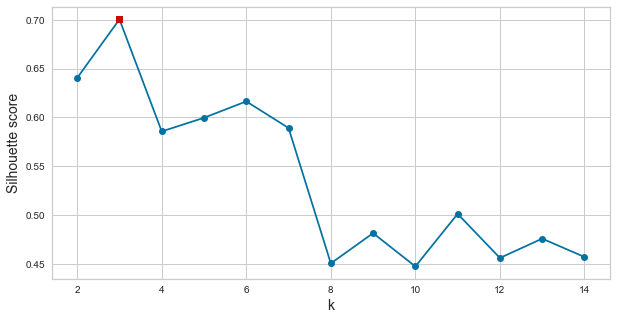

In [938]:
plt.figure(figsize=(10, 5))
plt.plot(range(2, 15), silhouette_scores, "bo-")
plt.xlabel("k", fontsize=14)
plt.ylabel("Silhouette score", fontsize=14)
plt.plot(best_k, best_score, 'rs')
plt.show()

In [939]:
best_model = kmeans_per_k[best_index]
best_model

KMeans(n_clusters=3, random_state=42)

In [940]:
y_pred = best_model.fit_predict(df_reduced)

In [941]:
for i in range(best_k):
    print(f"cluster {i + 1} contains: {np.sum(y_pred == i)} customers")

cluster 1 contains: 8174 customers
cluster 2 contains: 87776 customers
cluster 3 contains: 23190 customers


In [942]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=42)
df_reduced = tsne.fit_transform(df_prepared)

C:\ProgramData\Anaconda3\envs\envMl\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\ProgramData\Anaconda3\envs\envMl\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


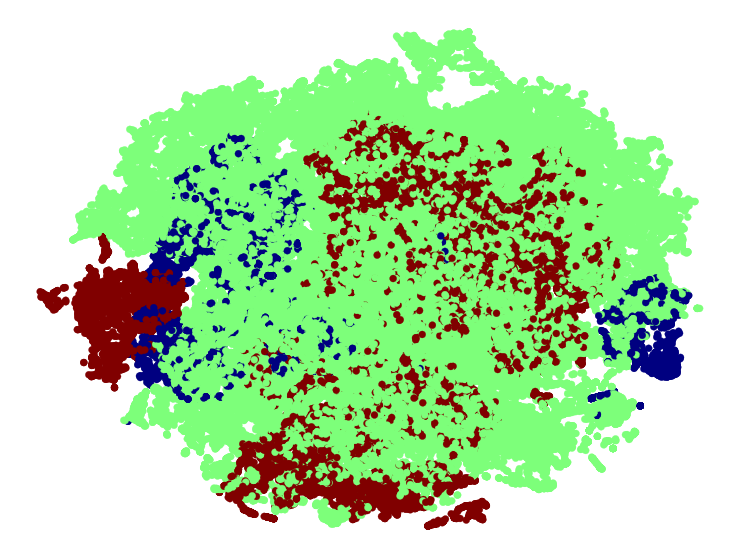

In [981]:
plt.figure(figsize=(13,10 ))
plt.scatter(df_reduced[:, 0], df_reduced[:, 1],c=y_pred, cmap="jet")
plt.axis('off')
plt.colorbar()
plt.show()

In [944]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=3, random_state=42)
df_reduced = tsne.fit_transform(df_prepared)

C:\ProgramData\Anaconda3\envs\envMl\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\ProgramData\Anaconda3\envs\envMl\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


C:\Users\USER\AppData\Local\Temp/ipykernel_17816/3136078939.py:4: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  plt.colorbar()


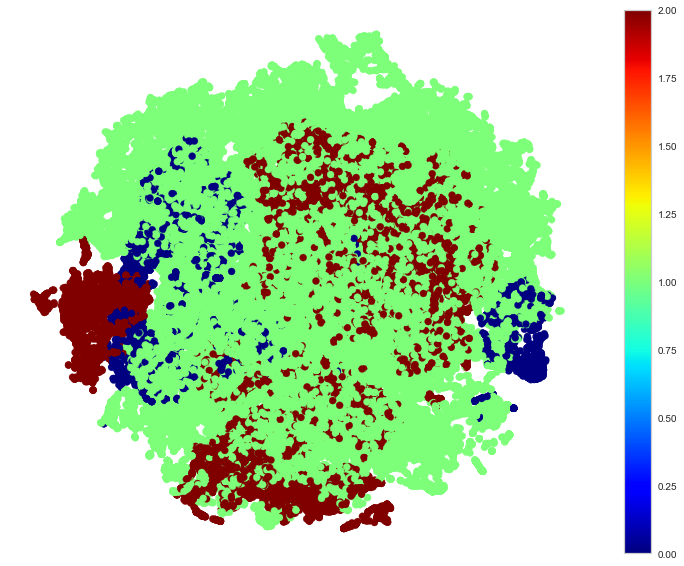

In [945]:
plt.figure(figsize=(13,10 ))
plt.scatter(df_reduced[:, 0], df_reduced[:, 1],c=y_pred, cmap="jet")
plt.axis('off')
plt.colorbar()
plt.show()

In [974]:
from IPython.display import HTML
import json

In [975]:
def render_pivot_table(pivot_table):  
    code = '''
<head>
   <script src="https://cdn.flexmonster.com/flexmonster.js"></script>
</head>
<body>
   <h1 style="margin-bottom: 15px;">Exploratory data analysis with a pivot table</h1>
   <div id="pivot-container"></div>
   <script>
      new Flexmonster({0});
   </script> 
</body>
      '''.format(pivot_table)
      #convert the code string to HTML
    return HTML(code)

In [976]:
json_data = df_full.to_json()

In [977]:
pivot_table = {
        "container": "#pivot-container",
        "componentFolder": "https://cdn.flexmonster.com/",
        "toolbar": True,
        "report": {
            "dataSource": {
                "type": "json",
                "data": json.loads(json_data)
            },
            "slice": {
                "rows": [{
                    "uniqueName": "weekday"
                }],
                "columns": [{
                    "uniqueName": "[Measures]"
                }],
                "measures": [{
                    "uniqueName": "count",
                    "aggregation": "median"
                }],
                "sorting": {
                    "column": {
                        "type": "desc",
                        "tuple": [],
                        "measure": {
                            "uniqueName": "count",
                            "aggregation": "median"
                        }
                    }
                }
            }
        }
    }

In [978]:
pivot_json_object = json.dumps(pivot_table)

In [979]:
render_pivot_table(pivot_json_object)